In [1]:
import torch; torch.manual_seed(0)
import torch.nn as nn
import torch.nn.functional as F
import torch.utils
import torch.distributions
import torchvision
import numpy as np
import pandas as pd
import torchvision.models as models 
from torchvision import transforms, utils
from torch.utils.data.sampler import SubsetRandomSampler
import torch.optim as optim
import matplotlib.pyplot as plt
import latent_plot as lp
from torch.autograd import Variable
from torch.optim import lr_scheduler
import seaborn as sns
import os
os.environ['CUDA_LAUNCH_BLOCKING'] = '1'
import copy
import math
#from model import VAE

import matplotlib.pyplot as plt; plt.rcParams['figure.dpi'] = 200
from data_loader import *
from model import convVAE
from sklearn.manifold import TSNE
import copy

In [2]:
#only on validation set
csv_path = '/home/vip/sayan-mandal/datasets/obj_criteria/20200619-objective.csv'
img_path = '/home/vip/sayan-mandal/datasets/obj_criteria/good_reduced/'

ResizeParam = 128
FD = FundusDataLoader(csv_path, img_path,transform=transforms.Compose([transforms.Resize(ResizeParam), transforms.RandomHorizontalFlip(p=0.5) ,transforms.ToTensor()]))
FD2 = FundusDataLoader(csv_path, img_path,transform=transforms.Compose([transforms.Resize(ResizeParam), transforms.ToTensor()]))

#random sampler
batch_size = 64
validation_split = .2
shuffle_dataset = True
random_seed= 42

# Creating data indices for training and validation splits:
dataset_size = len(FD)
indices = list(range(dataset_size))
split = int(np.floor(validation_split * dataset_size))
if shuffle_dataset :
    np.random.seed(random_seed)
    np.random.shuffle(indices)
val_indices =  indices[:split]

# Creating PT data samplers and loaders:
valid_sampler = SubsetRandomSampler(val_indices)

#train_loader = torch.utils.data.DataLoader(FD, batch_size=batch_size, sampler=train_sampler)
data_loader = torch.utils.data.DataLoader(FD2, batch_size=batch_size, sampler=valid_sampler)

In [3]:
#vae model structure
nl = 2048
model = convVAE((3,128,128),nl).cuda()
model.load_state_dict(torch.load('/home/vip/sayan-mandal/vae-convmodels/dfcvae_inp128_nl'+str(nl)+'_a1b1.torch'))
print(model)

convVAE(
  (encoder): Sequential(
    (0): Conv2d(3, 16, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (1): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): LeakyReLU(negative_slope=0.01)
    (3): Conv2d(16, 32, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (4): BatchNorm2d(32, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): LeakyReLU(negative_slope=0.01)
    (6): Conv2d(32, 64, kernel_size=(3, 3), stride=(1, 1), padding=(1, 1))
    (7): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): LeakyReLU(negative_slope=0.01)
    (9): Conv2d(64, 16, kernel_size=(3, 3), stride=(2, 2), padding=(1, 1))
    (10): BatchNorm2d(16, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): LeakyReLU(negative_slope=0.01)
    (12): Flatten(start_dim=1, end_dim=-1)
  )
  (fc1): Sequential(
    (0): Linear(in_features=16384, out_features=4096, bias=True)
    (1): BatchNo

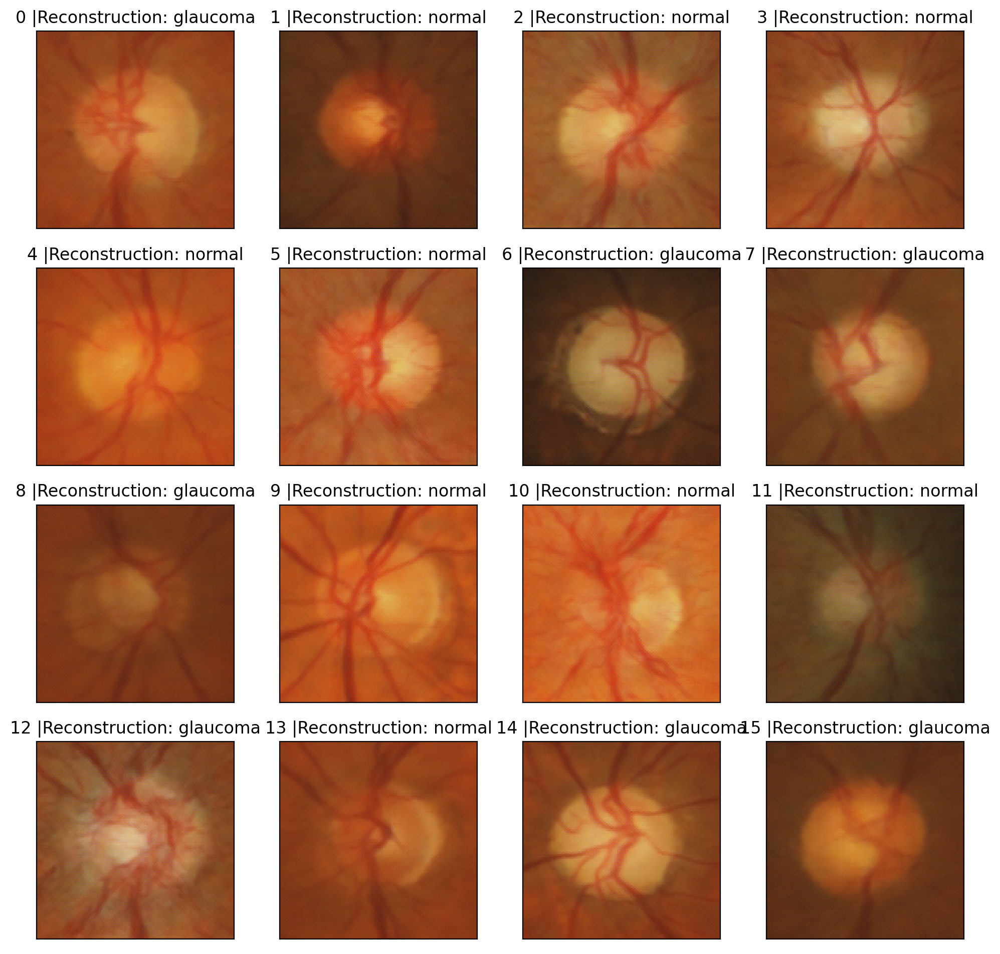

In [4]:
#Utility functions to un-normalize and display an image
def imshow(img):
    #img = img / 2 + 0.5  
    plt.imshow(np.transpose(img, (1, 2, 0))) 

#Define the image classes
classes = ['normal','glaucoma']

#Obtain one batch of training images
dataiter = iter(data_loader)
data, labels = dataiter.next()
model.eval()
images,_,_ = model(Variable(data).cuda())
images = images.detach().cpu().numpy() # convert images to numpy for display

#Plot the images
fig = plt.figure(figsize=(12, 12))
# display 20 images
idx = 0
while idx < 16:
    ax = fig.add_subplot(4,4, idx+1, xticks=[], yticks=[])
    imshow(images[idx])
    ax.set_title(str(idx) + " |Reconstruction: " + classes[labels[idx]])
    idx+=1


In [5]:
def interpolate(vaemodel, databatch,labels, rndnidx,fromidx, toidx, n):
    y, _, _ = vaemodel.encode(Variable(databatch).cuda())
    ybatch = torch.stack([y[rndnidx] + (y[toidx]-y[fromidx])*t for t in np.linspace(0,1,n)])
    #Plot the images
    images = vaemodel.decode(ybatch)
    images = images.detach().cpu().numpy()
    fig = plt.figure(figsize=(16, 6))
    # display 20 images
    classes = ['normal','glaucoma']
    for i in range(n):
        ax = fig.add_subplot(2,math.ceil(n/2), i+1, xticks=[], yticks=[])
        if i == 0:
            ax.set_title(classes[labels[rndnidx]])
        elif i == n-1:
            ax.set_title(classes[labels[toidx]])
        imshow(images[i])



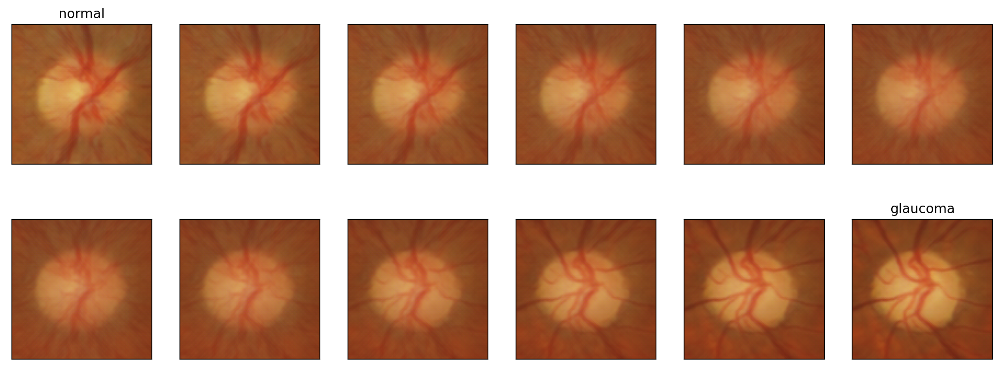

In [9]:
interpolate(model,data,labels,2,2,14,12)

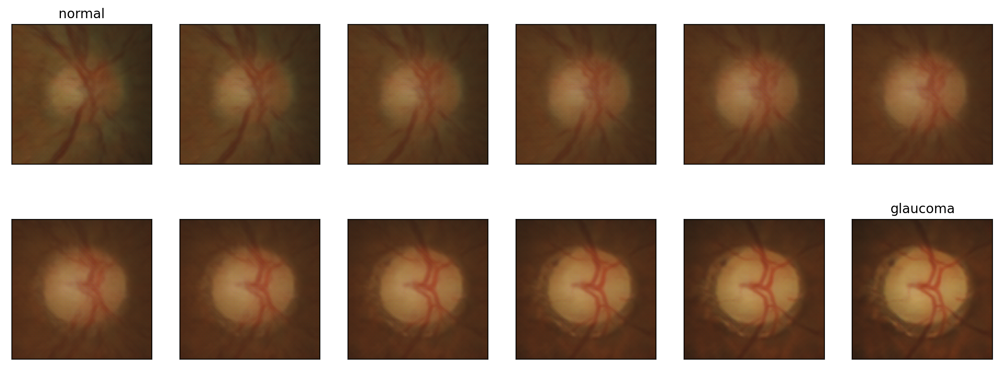

In [10]:
interpolate(model,data,labels,11,11,6,12)

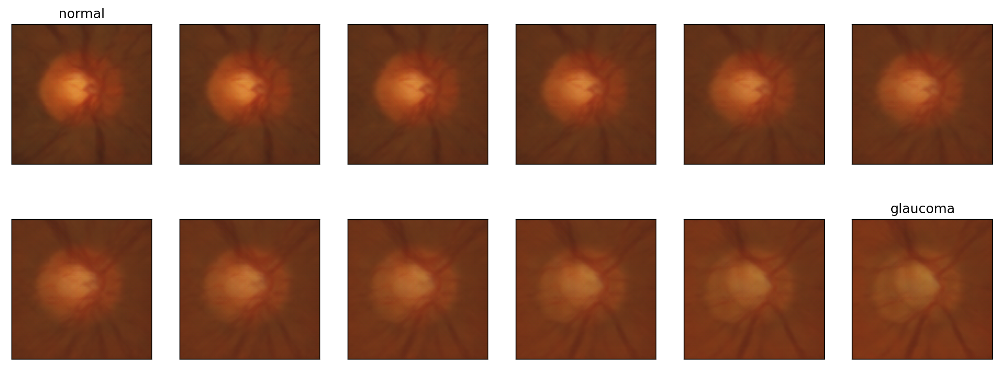

In [11]:
interpolate(model,data,labels,1,1,8,12)

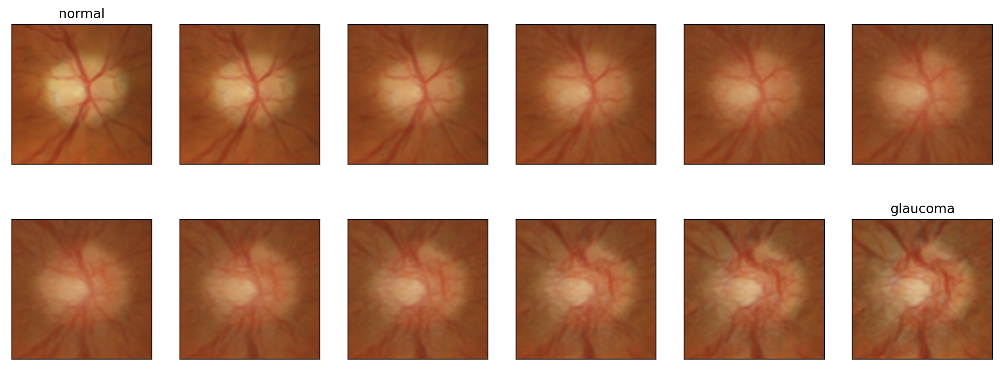

In [12]:
interpolate(model,data,labels,3,3,12,12)

In [6]:
#vae model structure
def plotimgs(nl = 2048):
    model = convVAE((3,128,128),nl).cuda()
    model.load_state_dict(torch.load('/home/vip/sayan-mandal/vae-convmodels/dfcvae_inp128_nl'+str(nl)+'_a1b1.torch'))


    model.eval()
    images,_,_ = model(Variable(data).cuda())
    images = images.detach().cpu().numpy() # convert images to numpy for display

    #Plot the images
    fig = plt.figure(figsize=(12, 12))
    # display 20 images
    idx = 0
    while idx < 3:
        ax = fig.add_subplot(1,3, idx+1, xticks=[], yticks=[])
        imshow(images[idx])
        ax.set_title(str(nl) + " LS: " + classes[labels[idx]])
        idx+=1

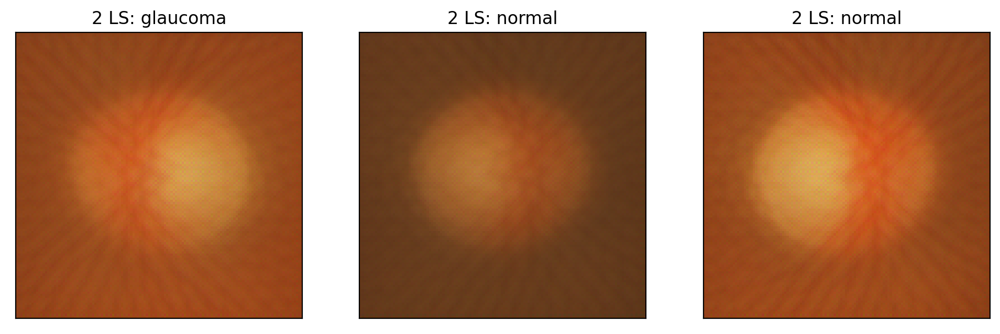

In [21]:
plotimgs(nl=2)

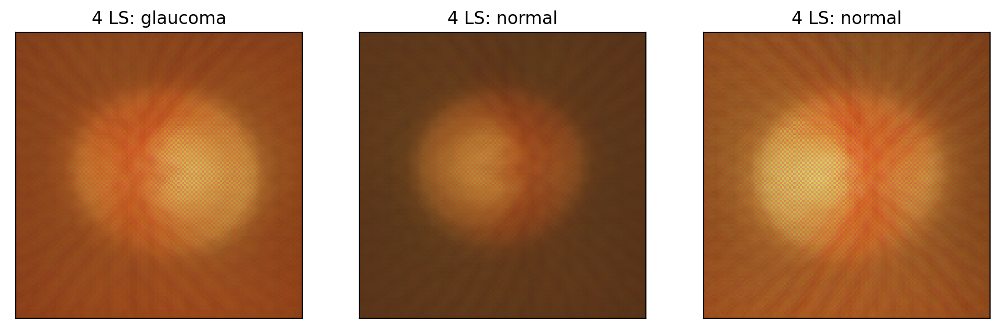

In [22]:
plotimgs(nl=4)

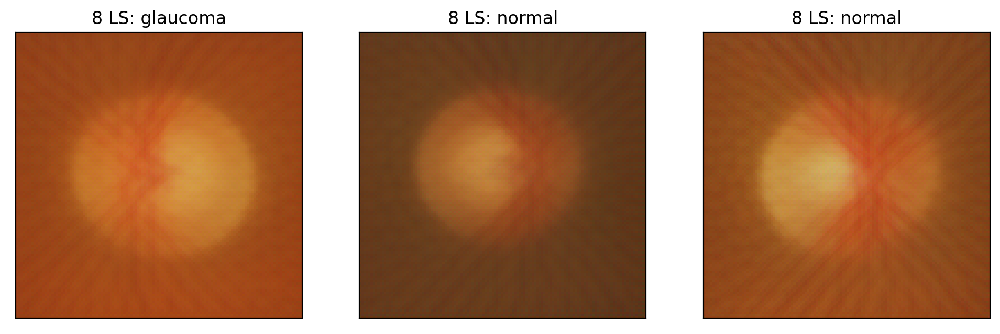

In [23]:
plotimgs(nl=int(4*2))

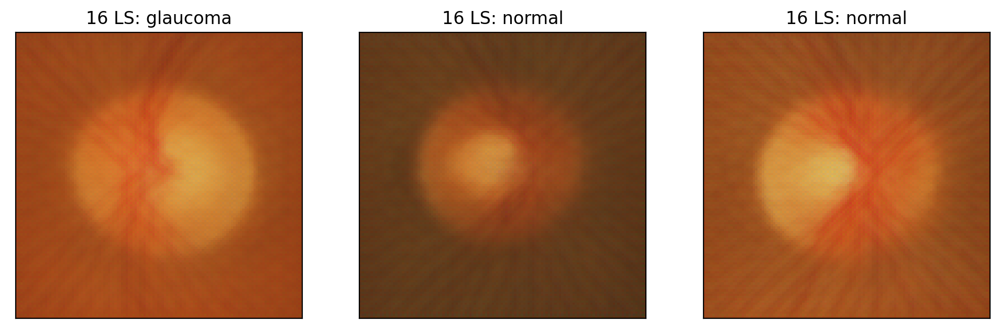

In [24]:
plotimgs(nl=int(8*2))

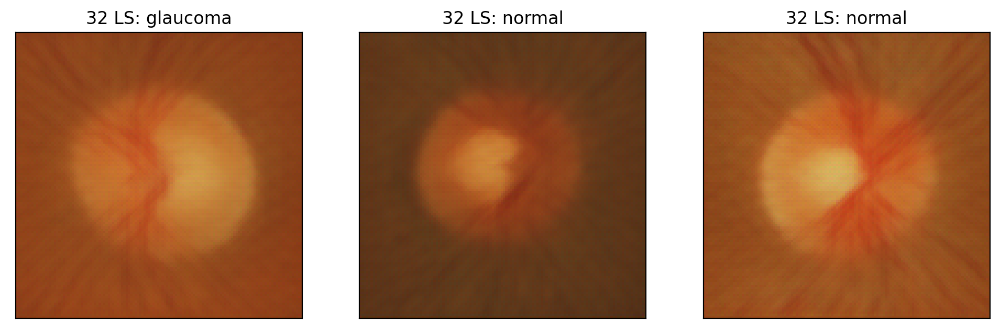

In [25]:
plotimgs(nl=int(16*2))

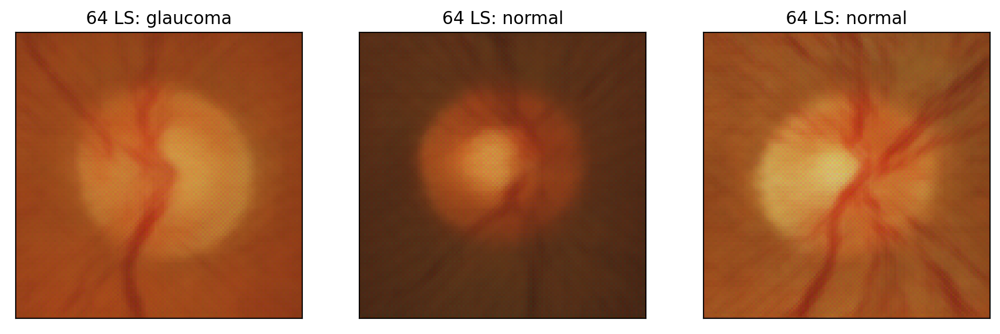

In [26]:
plotimgs(nl=int(32*2))

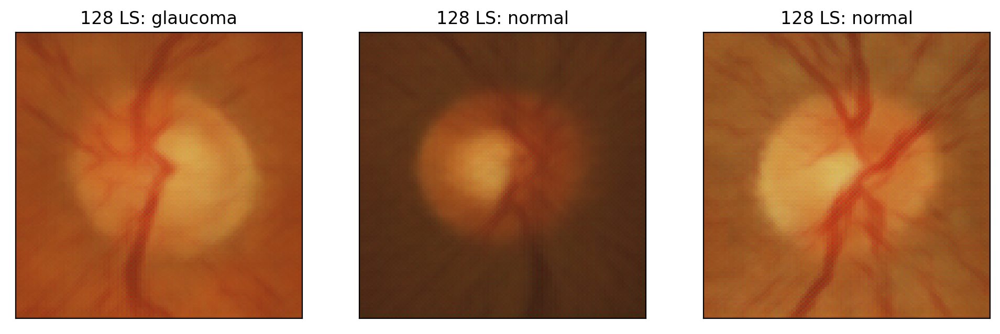

In [27]:
plotimgs(nl=int(64*2))

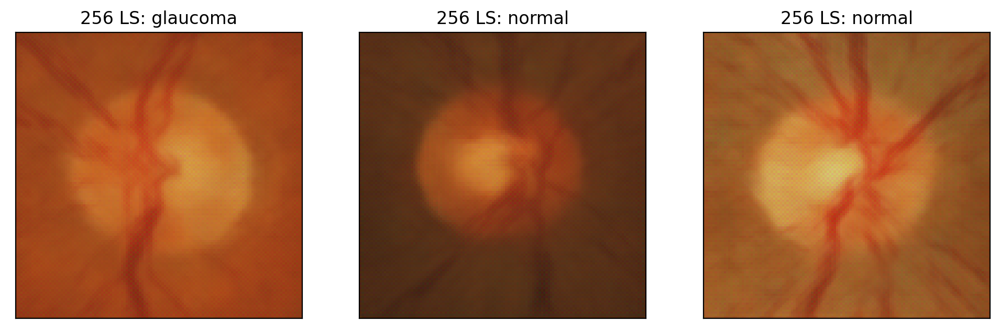

In [28]:
plotimgs(nl=int(128*2))

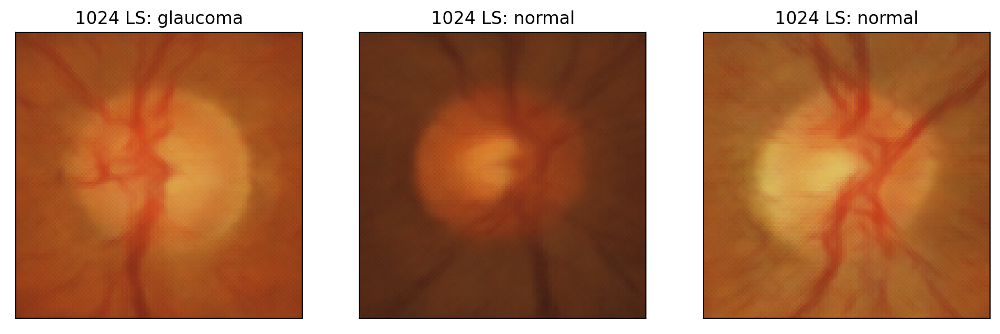

In [29]:
plotimgs(nl=int(512*2))

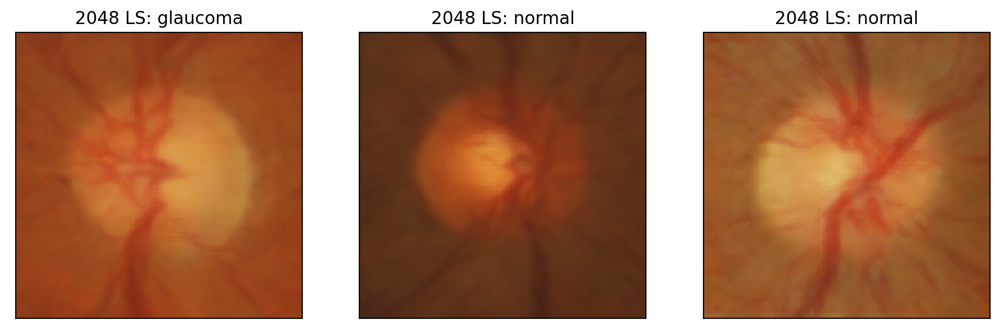

In [30]:
plotimgs(nl=int(1024*2))

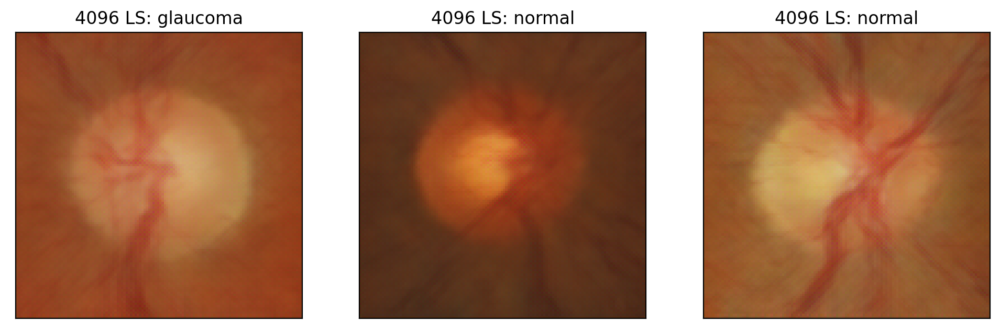

In [31]:
plotimgs(nl=int(2048*2))

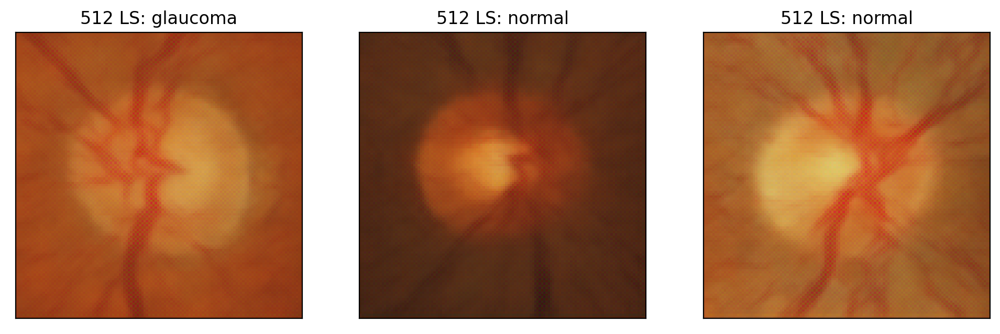

In [7]:
plotimgs(nl=int(512))

In [15]:
def plotdiff(vaemodel, databatch,labels,fromidx, toidx):
    y, _, _ = vaemodel.encode(Variable(databatch).cuda())
    ybatch = (y[toidx]-y[fromidx]).reshape(1,2048)
    #Plot the images
    images = vaemodel.decode(ybatch)
    images = images.detach().cpu().numpy()
    fig = plt.figure(figsize=(5, 5))
    ax = fig.add_subplot(1,1, 1, xticks=[], yticks=[])
    ax.set_title("Difference")
    imshow(images[0])



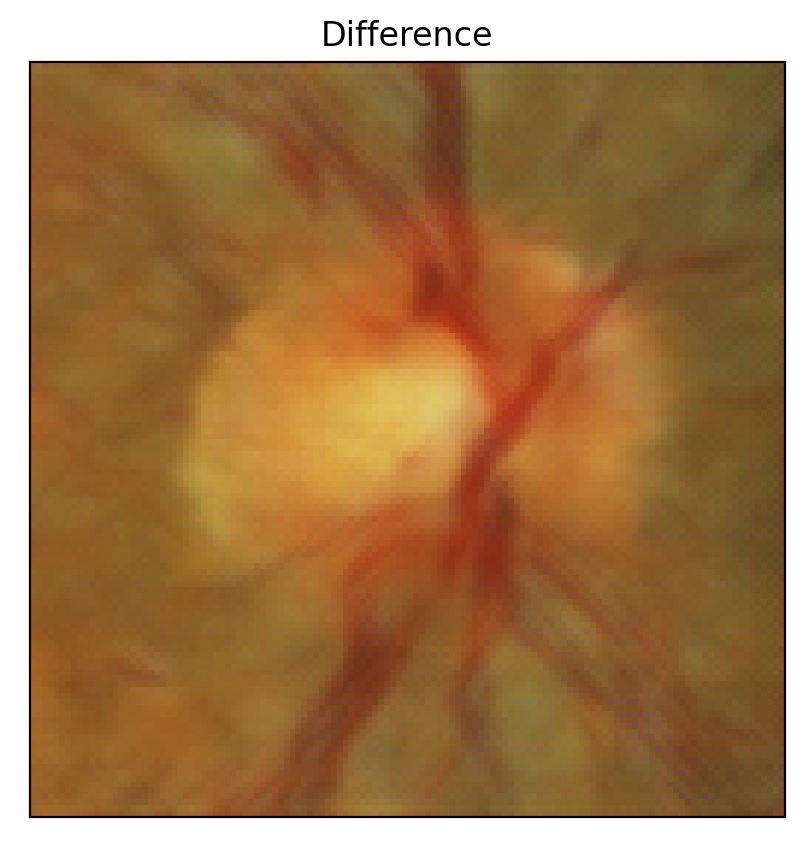

In [16]:
plotdiff(model,data,labels,14,2)

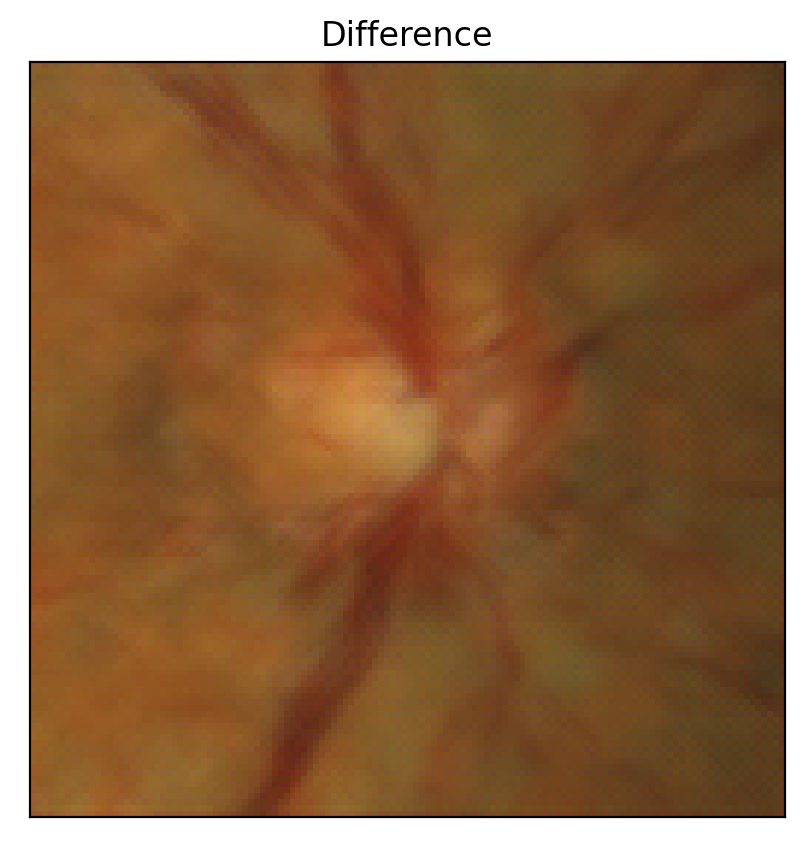

In [17]:
plotdiff(model,data,labels,6,11)

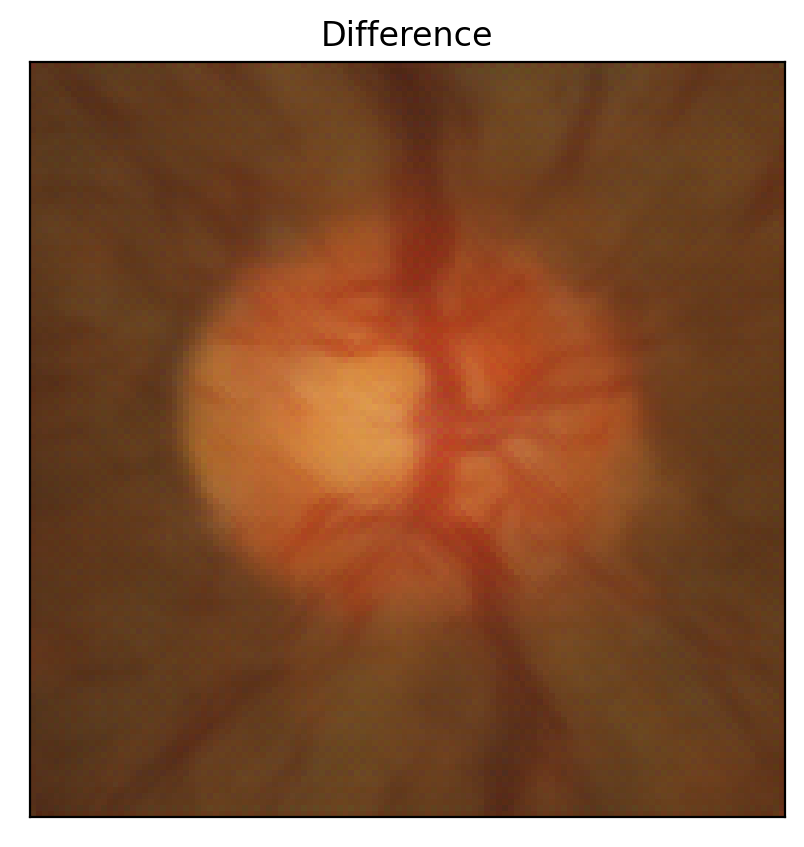

In [18]:
plotdiff(model,data,labels,8,1)

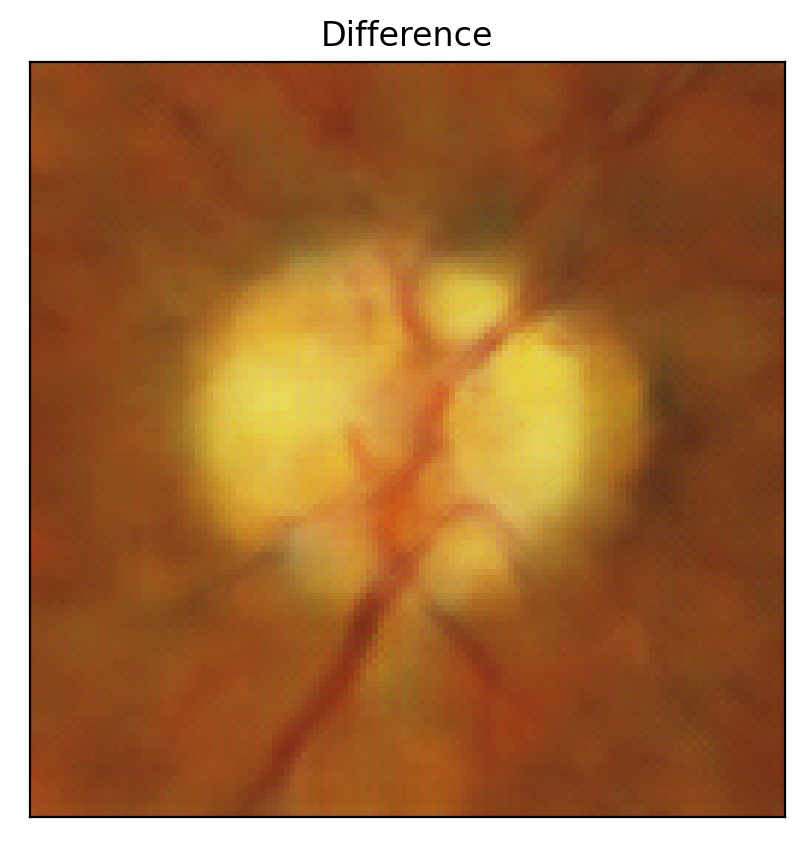

In [19]:
plotdiff(model,data,labels,12,3)